In [3]:
import tensorflow as tf
from tensorflow.keras.layers import GlobalAveragePooling2D,Dense,Dropout, Activation, Flatten
from tensorflow.keras.layers import Conv2D, MaxPool2D, ZeroPadding2D
from tensorflow.keras.layers import BatchNormalization
from tensorflow.keras.models import Model, Sequential
from tensorflow import keras    

2024-04-02 23:27:07.302592: I external/local_tsl/tsl/cuda/cudart_stub.cc:32] Could not find cuda drivers on your machine, GPU will not be used.
2024-04-02 23:27:07.446996: I external/local_tsl/tsl/cuda/cudart_stub.cc:32] Could not find cuda drivers on your machine, GPU will not be used.
2024-04-02 23:27:07.859630: I tensorflow/core/platform/cpu_feature_guard.cc:210] This TensorFlow binary is optimized to use available CPU instructions in performance-critical operations.
To enable the following instructions: AVX2 FMA, in other operations, rebuild TensorFlow with the appropriate compiler flags.
2024-04-02 23:27:10.214782: W tensorflow/compiler/tf2tensorrt/utils/py_utils.cc:38] TF-TRT Warning: Could not find TensorRT


In [4]:

from tensorflow.keras.applications import MobileNetV2

In [5]:
img_width,img_height=224,224

model=MobileNetV2(weights='imagenet',
                include_top=False,
                input_shape=(img_height,img_width,3)
                )

In [6]:
for (i,layer) in enumerate(model.layers):
    print(f"{i} {layer.__class__.__name__} {layer.trainable}")

0 InputLayer True
1 Conv2D True
2 BatchNormalization True
3 ReLU True
4 DepthwiseConv2D True
5 BatchNormalization True
6 ReLU True
7 Conv2D True
8 BatchNormalization True
9 Conv2D True
10 BatchNormalization True
11 ReLU True
12 ZeroPadding2D True
13 DepthwiseConv2D True
14 BatchNormalization True
15 ReLU True
16 Conv2D True
17 BatchNormalization True
18 Conv2D True
19 BatchNormalization True
20 ReLU True
21 DepthwiseConv2D True
22 BatchNormalization True
23 ReLU True
24 Conv2D True
25 BatchNormalization True
26 Add True
27 Conv2D True
28 BatchNormalization True
29 ReLU True
30 ZeroPadding2D True
31 DepthwiseConv2D True
32 BatchNormalization True
33 ReLU True
34 Conv2D True
35 BatchNormalization True
36 Conv2D True
37 BatchNormalization True
38 ReLU True
39 DepthwiseConv2D True
40 BatchNormalization True
41 ReLU True
42 Conv2D True
43 BatchNormalization True
44 Add True
45 Conv2D True
46 BatchNormalization True
47 ReLU True
48 DepthwiseConv2D True
49 BatchNormalization True
50 ReLU True

In [7]:
for layer in model.layers:
    layer.trainable=False

In [8]:
for (i,layer) in enumerate(model.layers):
    print(f"{i} {layer.__class__.__name__} {layer.trainable}")

0 InputLayer False
1 Conv2D False
2 BatchNormalization False
3 ReLU False
4 DepthwiseConv2D False
5 BatchNormalization False
6 ReLU False
7 Conv2D False
8 BatchNormalization False
9 Conv2D False
10 BatchNormalization False
11 ReLU False
12 ZeroPadding2D False
13 DepthwiseConv2D False
14 BatchNormalization False
15 ReLU False
16 Conv2D False
17 BatchNormalization False
18 Conv2D False
19 BatchNormalization False
20 ReLU False
21 DepthwiseConv2D False
22 BatchNormalization False
23 ReLU False
24 Conv2D False
25 BatchNormalization False
26 Add False
27 Conv2D False
28 BatchNormalization False
29 ReLU False
30 ZeroPadding2D False
31 DepthwiseConv2D False
32 BatchNormalization False
33 ReLU False
34 Conv2D False
35 BatchNormalization False
36 Conv2D False
37 BatchNormalization False
38 ReLU False
39 DepthwiseConv2D False
40 BatchNormalization False
41 ReLU False
42 Conv2D False
43 BatchNormalization False
44 Add False
45 Conv2D False
46 BatchNormalization False
47 ReLU False
48 DepthwiseCon

In [9]:
def add_layer_at_bottom(bottom_model, num_classes):
    top_model = bottom_model.output
    top_model = GlobalAveragePooling2D()(top_model)
    top_model = Dense(1024,activation='relu')(top_model)
    top_model = Dense(1024,activation='relu')(top_model)
    top_model = Dense(512,activation='relu')(top_model)
    top_model = Dense(num_classes,activation='softmax')(top_model)
    return top_model

## Data Prep

In [10]:
from tensorflow.keras.preprocessing.image import ImageDataGenerator

In [11]:
train_data_dir='/home/atinsharma/CAPSTONE/MainProjectGit/Medicinal-Plant-Identification/training_dataset'
val_data_dir='/home/atinsharma/CAPSTONE/MainProjectGit/Medicinal-Plant-Identification/testing_dataset' 


In [12]:
# from tensorflow.keras.layers.preprocessing.image_preprocessing import HORIZONTAL

train_datagen=ImageDataGenerator(rescale=1./255,
                                 rotation_range=45,
                                 width_shift_range=0.3,
                                 height_shift_range=0.3,
                                 horizontal_flip=True,
                                 fill_mode='nearest')

val_datagen=ImageDataGenerator(rescale=1./255)

In [13]:
batch_size=32

In [14]:
train_generator=train_datagen.flow_from_directory(train_data_dir,
                                                  target_size=(img_height,img_width),
                                                  batch_size=batch_size,
                                                  class_mode='categorical')

val_generator=val_datagen.flow_from_directory(val_data_dir,
                                              target_size=(img_height,img_width),
                                              batch_size=batch_size,
                                              class_mode='categorical')


Found 0 images belonging to 0 classes.


FileNotFoundError: [Errno 2] No such file or directory: './training_dataset'

In [ ]:
train_class_names = set()
num_train_samples=0
for i in train_generator.filenames:
    train_class_names.add(i.split('/')[0])
    num_train_samples+=1
print(num_train_samples)
train_class_names

NameError: name 'train_generator' is not defined

In [ ]:
val_class_names = set()
num_val_samples=0
for i in val_generator.filenames:
    val_class_names.add(i.split('/')[0])
    num_val_samples+=1
print(num_val_samples)
val_class_names

NameError: name 'val_generator' is not defined

In [ ]:
num_classes=len(train_generator.class_indices)
print(num_classes)
FC_head=add_layer_at_bottom(model,
                            num_classes)

main_model=Model(inputs=model.input,
                 outputs=FC_head)

main_model.summary()

10
Model: "model"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_1 (InputLayer)        [(None, 224, 224, 3)]        0         []                            
                                                                                                  
 Conv1 (Conv2D)              (None, 112, 112, 32)         864       ['input_1[0][0]']             
                                                                                                  
 bn_Conv1 (BatchNormalizati  (None, 112, 112, 32)         128       ['Conv1[0][0]']               
 on)                                                                                              
                                                                                                  
 Conv1_relu (ReLU)           (None, 112, 112, 32)         0         ['bn_Conv1[0][0]']     

 block_3_expand_relu (ReLU)  (None, 56, 56, 144)          0         ['block_3_expand_BN[0][0]']   
                                                                                                  
 block_3_pad (ZeroPadding2D  (None, 57, 57, 144)          0         ['block_3_expand_relu[0][0]'] 
 )                                                                                                
                                                                                                  
 block_3_depthwise (Depthwi  (None, 28, 28, 144)          1296      ['block_3_pad[0][0]']         
 seConv2D)                                                                                        
                                                                                                  
 block_3_depthwise_BN (Batc  (None, 28, 28, 144)          576       ['block_3_depthwise[0][0]']   
 hNormalization)                                                                                  
          

 block_6_depthwise_BN (Batc  (None, 14, 14, 192)          768       ['block_6_depthwise[0][0]']   
 hNormalization)                                                                                  
                                                                                                  
 block_6_depthwise_relu (Re  (None, 14, 14, 192)          0         ['block_6_depthwise_BN[0][0]']
 LU)                                                                                              
                                                                                                  
 block_6_project (Conv2D)    (None, 14, 14, 64)           12288     ['block_6_depthwise_relu[0][0]
                                                                    ']                            
                                                                                                  
 block_6_project_BN (BatchN  (None, 14, 14, 64)           256       ['block_6_project[0][0]']     
 ormalizat

                                                                                                  
 block_9_add (Add)           (None, 14, 14, 64)           0         ['block_8_add[0][0]',         
                                                                     'block_9_project_BN[0][0]']  
                                                                                                  
 block_10_expand (Conv2D)    (None, 14, 14, 384)          24576     ['block_9_add[0][0]']         
                                                                                                  
 block_10_expand_BN (BatchN  (None, 14, 14, 384)          1536      ['block_10_expand[0][0]']     
 ormalization)                                                                                    
                                                                                                  
 block_10_expand_relu (ReLU  (None, 14, 14, 384)          0         ['block_10_expand_BN[0][0]']  
 )        

                                                                                                  
 block_13_expand_relu (ReLU  (None, 14, 14, 576)          0         ['block_13_expand_BN[0][0]']  
 )                                                                                                
                                                                                                  
 block_13_pad (ZeroPadding2  (None, 15, 15, 576)          0         ['block_13_expand_relu[0][0]']
 D)                                                                                               
                                                                                                  
 block_13_depthwise (Depthw  (None, 7, 7, 576)            5184      ['block_13_pad[0][0]']        
 iseConv2D)                                                                                       
                                                                                                  
 block_13_

 iseConv2D)                                                                                       
                                                                                                  
 block_16_depthwise_BN (Bat  (None, 7, 7, 960)            3840      ['block_16_depthwise[0][0]']  
 chNormalization)                                                                                 
                                                                                                  
 block_16_depthwise_relu (R  (None, 7, 7, 960)            0         ['block_16_depthwise_BN[0][0]'
 eLU)                                                               ]                             
                                                                                                  
 block_16_project (Conv2D)   (None, 7, 7, 320)            307200    ['block_16_depthwise_relu[0][0
                                                                    ]']                           
          

# Training

In [ ]:
from tensorflow.keras.optimizers import RMSprop
from tensorflow.keras.callbacks import ModelCheckpoint, EarlyStopping

In [ ]:

checkpoint = ModelCheckpoint("Model.h5",
                             monitor='val_loss',
                             mode='min',
                             save_best_only=True,verbose=1)

earlystop = EarlyStopping(monitor='val_loss',
                          min_delta=0,
                          patience=2,
                          verbose=1,
                          restore_best_weights=True)

callbacks=[checkpoint,earlystop]

main_model.compile(loss='categorical_crossentropy',
                   optimizer=RMSprop(learning_rate=0.001),
                   metrics=['accuracy'])

epochs=50

batch_size = 32

history = main_model.fit(train_generator,
                         steps_per_epoch=num_train_samples//batch_size,
                         epochs=epochs,
                         callbacks=callbacks,
                         validation_data=val_generator,
                         validation_steps=num_val_samples//batch_size)



Epoch 1/50


63/63 [==============================] - ETA: 0s - loss: 1.4840 - accuracy: 0.5850
Epoch 1: val_loss improved from inf to 0.77513, saving model to Model.h5


C:\Users\ys00s\anaconda3\Lib\site-packages\keras\src\engine\training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


63/63 [==============================] - 68s 1s/step - loss: 1.4840 - accuracy: 0.5850 - val_loss: 0.7751 - val_accuracy: 0.7604
Epoch 2/50
63/63 [==============================] - ETA: 0s - loss: 0.6319 - accuracy: 0.8060
Epoch 2: val_loss improved from 0.77513 to 0.35413, saving model to Model.h5
63/63 [==============================] - 53s 840ms/step - loss: 0.6319 - accuracy: 0.8060 - val_loss: 0.3541 - val_accuracy: 0.9010
Epoch 3/50
63/63 [==============================] - ETA: 0s - loss: 0.4663 - accuracy: 0.8584
Epoch 3: val_loss did not improve from 0.35413
63/63 [==============================] - 53s 845ms/step - loss: 0.4663 - accuracy: 0.8584 - val_loss: 0.4448 - val_accuracy: 0.8750
Epoch 4/50
63/63 [==============================] - ETA: 0s - loss: 0.3332 - accuracy: 0.8968
Epoch 4: val_loss did not improve from 0.35413
Restoring model weights from the end of the best epoch: 2.
63/63 [==============================] - 52s 828ms/step - loss: 0.3332 - accuracy: 0.8968 - val

In [ ]:
import matplotlib.pyplot as plt

<function matplotlib.pyplot.show(close=None, block=None)>

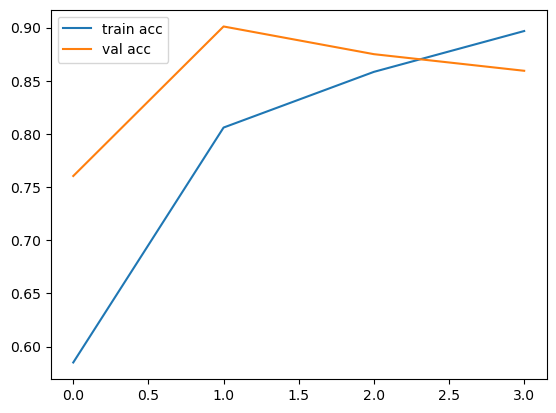

In [ ]:
#accuracy
plt.plot(history.history['accuracy'], label= 'train acc')
plt.plot(history.history['val_accuracy'], label= 'val acc')
plt.legend()
# plt.saveig('vcc-acc-rps-1.png')
plt.show

<function matplotlib.pyplot.show(close=None, block=None)>

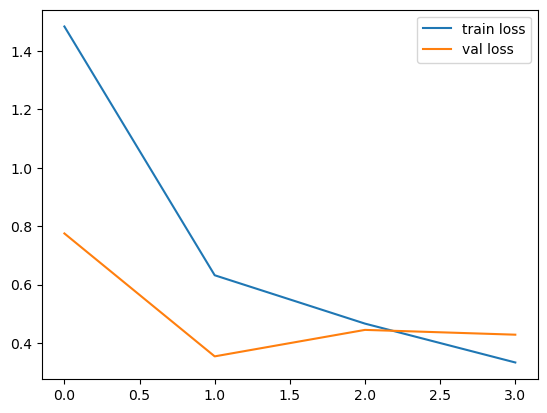

In [ ]:
#loss
plt.plot(history.history['loss'], label= 'train loss')
plt.plot(history.history['val_loss'], label= 'val loss')
plt.legend()
# plt.saveig('vcc-loss-rps-1.png')
plt.show

## Inference

In [ ]:
pip install opencv-python

  Obtaining dependency information for opencv-python from https://files.pythonhosted.org/packages/38/d2/3e8c13ffc37ca5ebc6f382b242b44acb43eb489042e1728407ac3904e72f/opencv_python-4.8.1.78-cp37-abi3-win_amd64.whl.metadata
   ---------------------------------------- 0.0/38.1 MB ? eta -:--:--
   ---------------------------------------- 0.0/38.1 MB ? eta -:--:--
   ---------------------------------------- 0.0/38.1 MB 435.7 kB/s eta 0:01:28
   ---------------------------------------- 0.1/38.1 MB 544.7 kB/s eta 0:01:10
   ---------------------------------------- 0.1/38.1 MB 656.4 kB/s eta 0:00:58
   ---------------------------------------- 0.1/38.1 MB 656.4 kB/s eta 0:00:58
   ---------------------------------------- 0.2/38.1 MB 614.4 kB/s eta 0:01:02
   ---------------------------------------- 0.2/38.1 MB 692.4 kB/s eta 0:00:55
   ---------------------------------------- 0.2/38.1 MB 684.7 kB/s eta 0:00:56
   ---------------------------------------- 0.3/38.1 MB 735.2 kB/s eta 0:00:52
   ----

1/1 [==============================] - 0s 61ms/step
[[2.3802578e-04 2.6118894e-06 4.2493443e-04 2.6545313e-04 9.9038529e-01
  1.9497722e-03 7.8098511e-04 5.9416117e-03 1.2247704e-06 1.0119903e-05]]


'Castor'

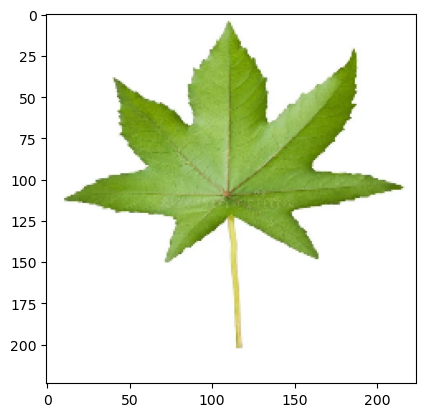

In [ ]:
import cv2
out=['Aloevera',
 'Amaranthus Viridis (Arive - Dantu)',
 'Amruthabali',
 'Arali',
 'Castor',
 'Mango',
 'Mint',
 'Neem',
 'Sandalwood',
 'Turmeric'
 ]
img=cv2.imread("test6.jpg")
img=cv2.cvtColor(img,cv2.COLOR_BGR2RGB)
img=cv2.resize(img,(224,224))
img=img/255.
import matplotlib.pyplot as plt
plt.imshow(img)
img=img.reshape(1,224,224,3)
import numpy as np
res=main_model.predict(img)
print(res)
out[np.argmax(res)]

In [ ]:
#predict
from sklearn.metrics import accuracy_score, classification_report, confusion_matrix
import numpy as np

y_pred = model.predict(val_generator)


7/7 [==============================] - 7s 843ms/step


In [ ]:
test_y = val_generator.classes

In [ ]:
converter = tf.lite.TFLiteConverter.from_keras_model(model)

In [ ]:
tflite_model = converter.convert()

INFO:tensorflow:Assets written to: C:\Users\ys00s\AppData\Local\Temp\tmpn1k_prsu\assets


INFO:tensorflow:Assets written to: C:\Users\ys00s\AppData\Local\Temp\tmpn1k_prsu\assets


In [ ]:
tflite_model

b'\x1c\x00\x00\x00TFL3\x14\x00 \x00\x1c\x00\x18\x00\x14\x00\x10\x00\x0c\x00\x00\x00\x08\x00\x04\x00\x14\x00\x00\x00\x1c\x00\x00\x00\x90\x00\x00\x00\xe8\x00\x00\x00\xc4\xbb\x86\x00\xd4\xbb\x86\x00x7\x87\x00\x03\x00\x00\x00\x01\x00\x00\x00\x10\x00\x00\x00\x00\x00\n\x00\x10\x00\x0c\x00\x08\x00\x04\x00\n\x00\x00\x00\x0c\x00\x00\x00\x1c\x00\x00\x00<\x00\x00\x00\x0f\x00\x00\x00serving_default\x00\x01\x00\x00\x00\x04\x00\x00\x00\x98\xff\xff\xff\xab\x00\x00\x00\x04\x00\x00\x00\x08\x00\x00\x00out_relu\x00\x00\x00\x00\x01\x00\x00\x00\x04\x00\x00\x00JEy\xff\x04\x00\x00\x00\x07\x00\x00\x00input_1\x00\x02\x00\x00\x004\x00\x00\x00\x04\x00\x00\x00\xdc\xff\xff\xff\xae\x00\x00\x00\x04\x00\x00\x00\x13\x00\x00\x00CONVERSION_METADATA\x00\x08\x00\x0c\x00\x08\x00\x04\x00\x08\x00\x00\x00\xad\x00\x00\x00\x04\x00\x00\x00\x13\x00\x00\x00min_runtime_version\x00\xaf\x00\x00\x00\xd8\xba\x86\x00\xd0\xba\x86\x00@\xba\x86\x00\xa8\xb9\x86\x00\x18\xb8\x86\x00\x88\xb6\x86\x008\xb4\x86\x00\xe8\xb1\x86\x00\x98\xaf\x86\x00

In [ ]:
with open('model.tflite', 'wb') as model_:
    model_.write(tflite_model)

In [ ]:
train_data_dir='dataset/train'
val_data_dir='dataset/test'

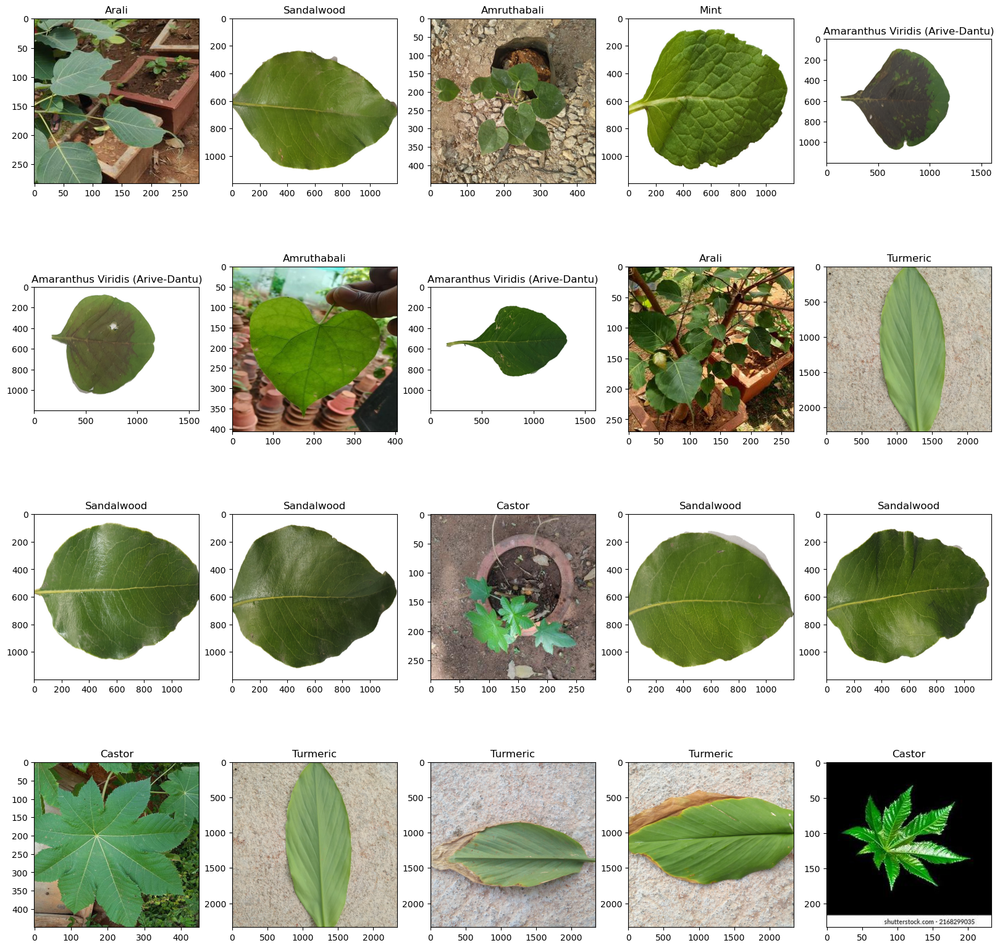

In [ ]:
plt.figure(figsize=(20,20))
img_folder = r'dataset/train'
for i in range(20):
  file = random.choice(os.listdir(img_folder))
  directory_name = file
  data = r'dataset/train/'+file
  file = random.choice(os.listdir(data))
  image_path = os.path.join(data, file)
  img = mpimg.imread(image_path)
  ax = plt.subplot(4,5,i+1)
  ax.title.set_text(directory_name)
  plt.imshow(img)
  plt.savefig('train-dataset.png')

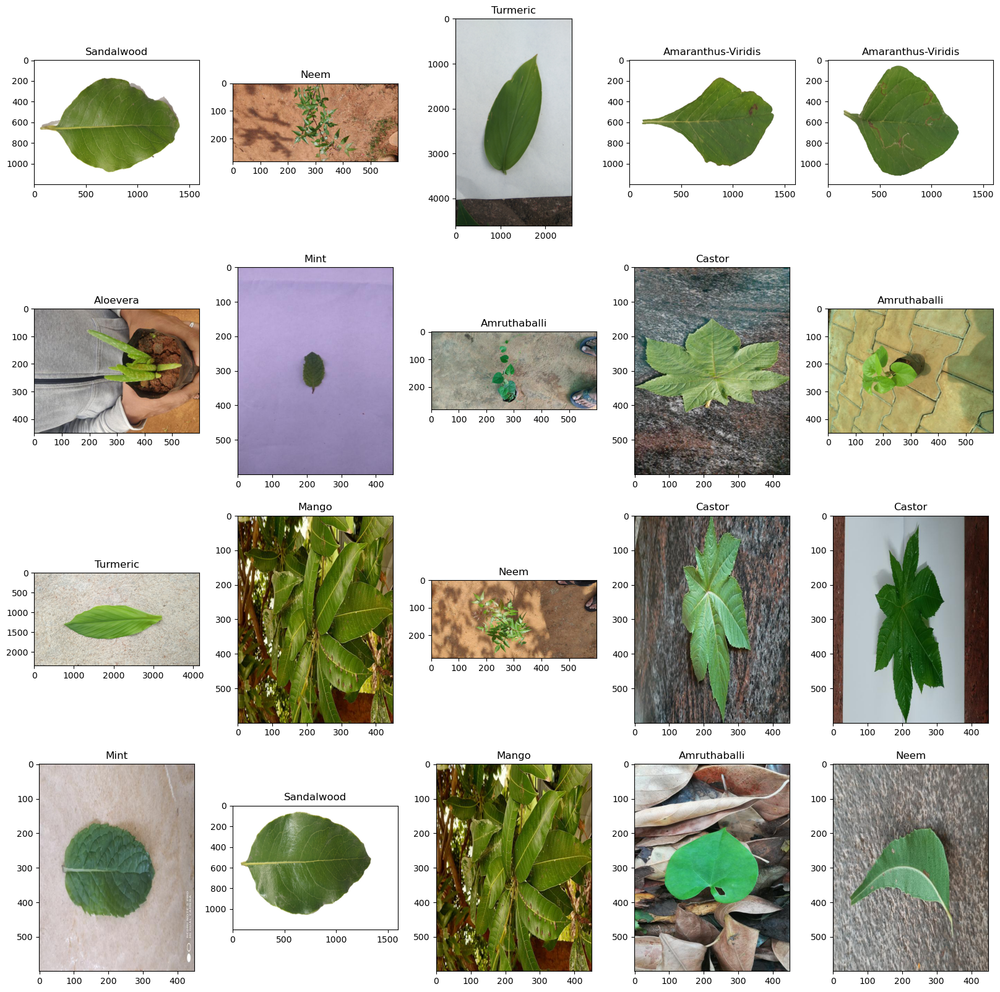

In [ ]:
plt.figure(figsize=(20,20))
img_folder = r'dataset/test'
for i in range(20):
  file = random.choice(os.listdir(img_folder))
  directory_name = file
  data = r'dataset/test/'+file
  file = random.choice(os.listdir(data))
  image_path = os.path.join(data, file)
  img = mpimg.imread(image_path)
  ax = plt.subplot(4,5,i+1)
  ax.title.set_text(directory_name)
  plt.imshow(img)
  plt.savefig('test-dataset.png')

In [ ]:
from PIL import Image
from numpy import asarray
out=['Aloevera',
 'Amaranthus Viridis (Arive - Dantu)',
 'Amruthabali',
 'Arali',
 'Castor',
 'Mango',
 'Mint',
 'Neem',
 'Sandalwood',
 'Turmeric'
 ]



1/1 [==============================] - 1s 1s/step
[[1.0516233e-03 6.4387423e-05 4.1585625e-03 1.4230578e-01 5.9229320e-01
  2.5040305e-01 7.9020526e-04 8.7609999e-03 2.5780049e-05 1.4643384e-04]]
1/1 [==============================] - 0s 65ms/step
[[5.6288661e-07 7.8017081e-08 6.0204053e-05 9.9527776e-01 2.2509014e-03
  2.3398921e-03 1.4458684e-06 6.9193200e-05 2.6918714e-08 3.2343639e-08]]
1/1 [==============================] - 0s 72ms/step
[[8.3808387e-05 6.8507020e-06 4.6056096e-04 1.8725090e-05 4.1907850e-05
  8.4615745e-02 2.5496338e-04 2.8096314e-05 5.9108268e-05 9.1443020e-01]]
1/1 [==============================] - 0s 57ms/step
[[1.9123290e-07 1.0699878e-06 9.9984503e-01 2.8617681e-06 2.6524523e-05
  8.4295651e-05 6.6674886e-07 3.9237326e-05 1.2052611e-08 1.8005361e-08]]
1/1 [==============================] - 0s 53ms/step
[[8.1665286e-07 2.0361955e-07 4.2431609e-05 9.9857187e-01 8.1158883e-04
  5.1012053e-04 2.1946453e-06 6.0657538e-05 1.0071606e-07 4.9069360e-08]]
1/1 [=======

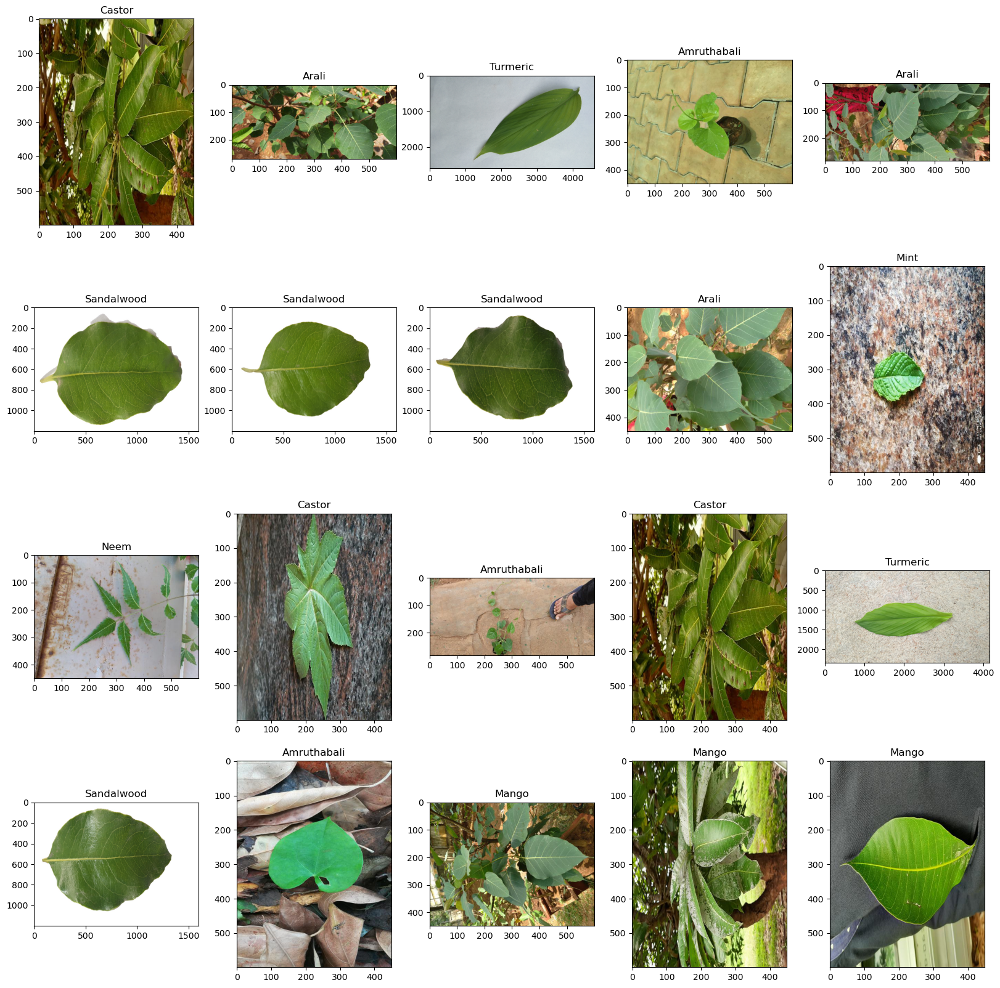

In [ ]:
import matplotlib.pyplot as plt
import numpy as np
plt.figure(figsize=(20,20))
img_folder = r'dataset/test'
for i in range(20):
  file = random.choice(os.listdir(img_folder))
  directory_name = file
  data = r'dataset/test/'+file
  file = random.choice(os.listdir(data))
  image_path = os.path.join(data, file)
  img = Image.open(image_path)
  img = img.resize((224,224))
  img = asarray(img)

  img=img/255.
  img_=img.reshape(1,224,224,3)

  res=model_new.predict(img_)
  print(res)
  
  img = mpimg.imread(image_path)
  ax = plt.subplot(4,5,i+1)
  ax.title.set_text(out[np.argmax(res)])
  plt.imshow(img)
  plt.savefig('predictions.png')